In [1]:
import pandas as pd
import utils
import numpy

In [2]:
#---------------------------------------------------
#
# Config *** TO UPDATE ***
#
#---------------------------------------------------

# *** TO UPDATE: change the team number with your own team number
TEAM_NUMBER = "TeamDemo"

# Path of the stimulus images for the different tasks 
STIMULUS_IMAGE_WITH_AOIS_PATH = "../raw-data/"+TEAM_NUMBER+"/stimulus image with aois/"

# This file should be automatically generated from "2. Event Detection"
GAZE_DATA_WITH_AOIS_AND_EVENTS_FILE = "data/gazeDataWithAOIsAndEvents.csv"

# Display size
DISPLAY_SIZE = (1920,1080)

In [3]:
#----------------------------------------------------------------------------------------
#
#
# 1. Fixations plots
#
#
#----------------------------------------------------------------------------------------

In [4]:
# Read gaze data with events using pandas library
data = pd.read_csv(GAZE_DATA_WITH_AOIS_AND_EVENTS_FILE)
# set display.max_columns to none, to show all the columns when using head()
pd.set_option('display.max_columns', None)

In [5]:
# Preview data
data.head()

,Row,Respondent,Age,Gender,Group,Calibration,Timestamp,SourceStimuliName,EventSource.1,ET_PupilLeft,ET_PupilRight,ET_TimeSignal,ET_CameraLeftX,ET_CameraLeftY,ET_CameraRightX,ET_CameraRightY,ET_ValidityLeft,ET_ValidityRight,GazeX,GazeY,Chat,CTA_1,Date_Place_1,Date_Place_2,Description_1,Description_2,Fav,Food,Gen_Info,Ingredients,Instructions,Online,Participants_Overview,Participant_Bio,Participant_Profile_Picture,Place,Responsabilities,Status,Verified,InterpolatedGazeX,InterpolatedGazeY,InterpolatedDistance,GazeVelocityAngle,FixID,Fixation Index by Stimulus,Fixation X,Fixation Y,Fixation Start,Fixation End,Fixation Duration,Fixation Dispersion,GazeAccelerationAngle,SacID,Saccade Index by Stimulus,Saccade Start,Saccade End,Saccade Duration,Saccade Amplitude,Saccade Peak Velocity,Saccade Peak Acceleration,Saccade Peak Deceleration,Saccade Direction
0,2,P01,0,OTHER,Default,Excellent,113.2910,Slide1,1,3.3239,3.2398,149.999,0.5685,0.4986,0.4194,0.4988,0,0,1077.5,558.5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1077.5,558.5,653.8869,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3,P01,0,OTHER,Default,Excellent,121.6164,Slide1,1,NaN,NaN,158.325,0.5685,0.4985,0.4194,0.4986,0,0,1079.0,560.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1079.0,560.0,653.9277,10.8007,1.0,NaN,1077.5797,563.1233,117.4537,375.7792,258.3255,0.2166,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,4,P01,0,OTHER,Default,Excellent,129.9499,Slide1,1,NaN,NaN,166.658,0.5687,0.4984,0.4195,0.4985,0,0,1080.0,565.5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1080.0,565.5,654.0243,10.5689,1.0,NaN,1077.5797,563.1233,117.4537,375.7792,258.3255,0.2166,-27.8160,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5,P01,0,OTHER,Default,Excellent,138.2936,Slide1,1,NaN,NaN,175.002,NaN,NaN,NaN,NaN,4,4,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1077.0,567.0,654.0483,9.7254,1.0,NaN,1077.5797,563.1233,117.4537,375.7792,258.3255,0.2166,-101.0827,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,6,P01,0,OTHER,Default,Excellent,146.6364,Slide1,1,NaN,NaN,183.345,0.5686,0.4983,0.4195,0.4983,0,0,1074.0,568.5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1074.0,568.5,654.0723,3.8549,1.0,NaN,1077.5797,563.1233,117.4537,375.7792,258.3255,0.2166,-703.6661,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# Derive a dataframe with fixation data only
# Keep only relevant colomns
fixationData = data[['Respondent','SourceStimuliName','FixID',
       'Fixation X', 'Fixation Y',
       'Fixation Duration']].copy(deep=True)

# Since the same fixation is assigned to multiple gazes, it is necessary to drop duplicates
fixationData = fixationData.drop_duplicates()

# Then, it is necessary to drop rows with no FixID
fixationData = fixationData.dropna(subset=['FixID'])

# Reset the index of the dataframe
fixationData = fixationData.reset_index(drop=True)

In [7]:
# Preview fixationData
fixationData.head()

,Respondent,SourceStimuliName,FixID,Fixation X,Fixation Y,Fixation Duration
0,P01,Slide1,1.0,1077.5797,563.1233,258.3255
1,P01,Slide1,2.0,700.4548,575.5617,258.2803
2,P01,Slide1,3.0,301.9617,505.5936,124.9673
3,P01,Slide1,4.0,322.8968,481.9830,124.9748
4,P01,Slide1,5.0,328.9948,285.3788,333.2623


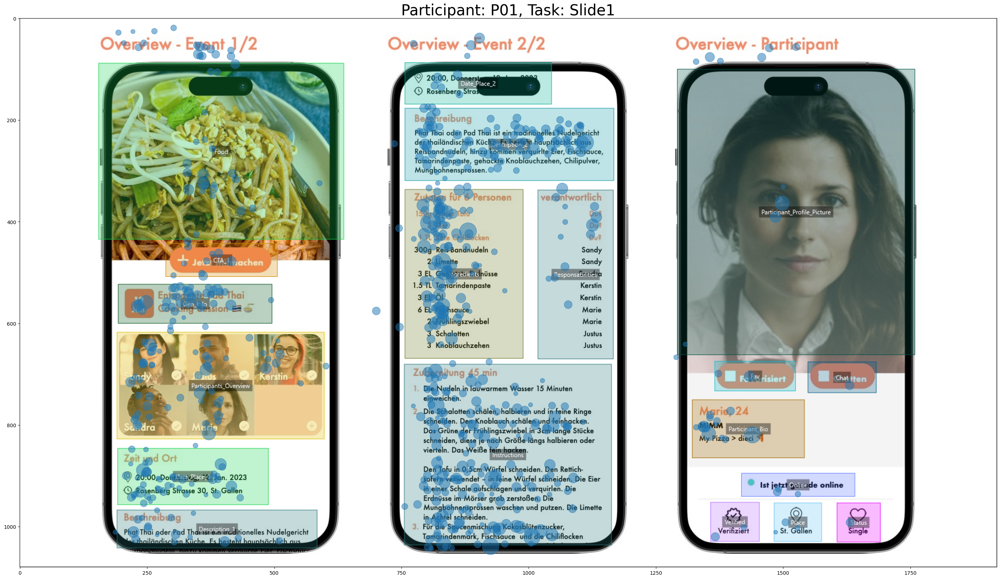

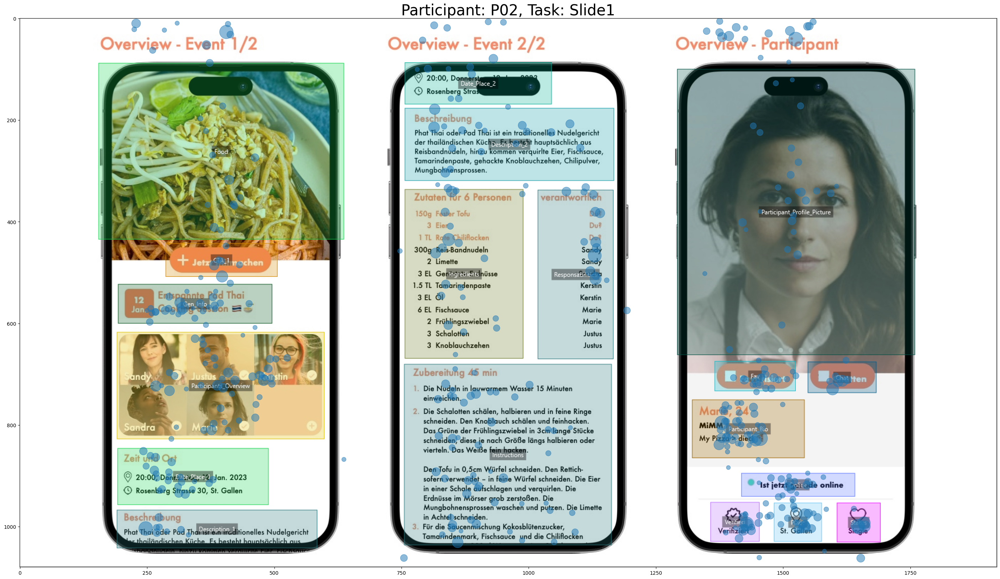

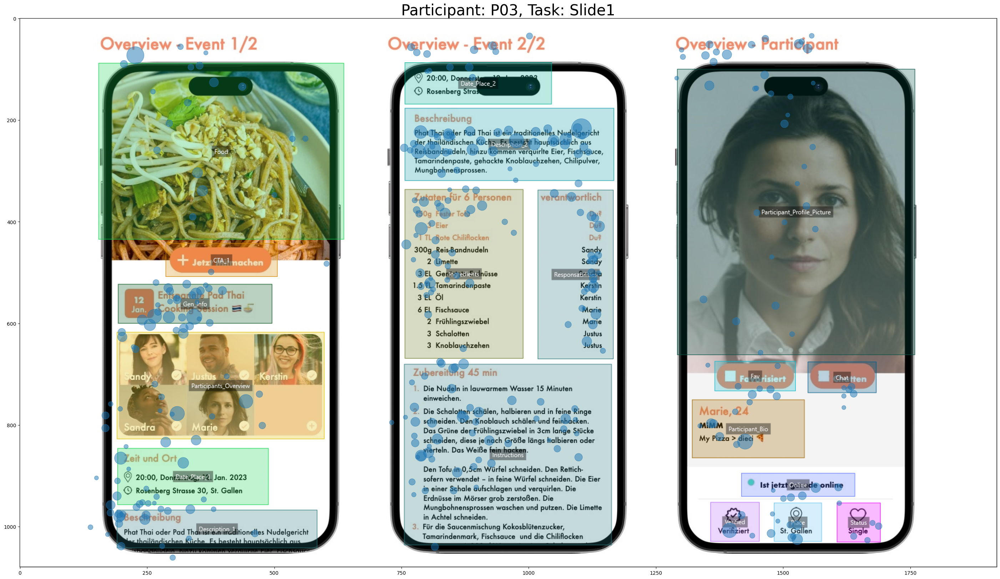

In [8]:
# Plot fixations

# Iteratate over the participants and tasks and plot fixations for each participant and task
for participant in fixationData['Respondent'].unique():
    
    for task in fixationData['SourceStimuliName'].unique():
    
        # filter in the participant and task data
        participantTaskFixationData= fixationData[(fixationData['Respondent']==participant) & (fixationData['SourceStimuliName']==task)].copy(deep=True)

        # Path to the stimulus image
        image_path = STIMULUS_IMAGE_WITH_AOIS_PATH+task+'.png'

        # Initiate a coordinate system with a background image
        fig, ax = utils.initPlotContainer(image_path)

        # set title
        ax.set_title(f'Participant: {participant}, Task: {task}', fontsize=30)

        # plot fixations (with the size of the markers relative to the fixation duration)
        ax.scatter(participantTaskFixationData["Fixation X"], participantTaskFixationData["Fixation Y"], s= participantTaskFixationData["Fixation Duration"], alpha=0.5)
    

In [9]:
#----------------------------------------------------------------------------------------
#
#
# 2. Scan-path plots
#
#
#----------------------------------------------------------------------------------------

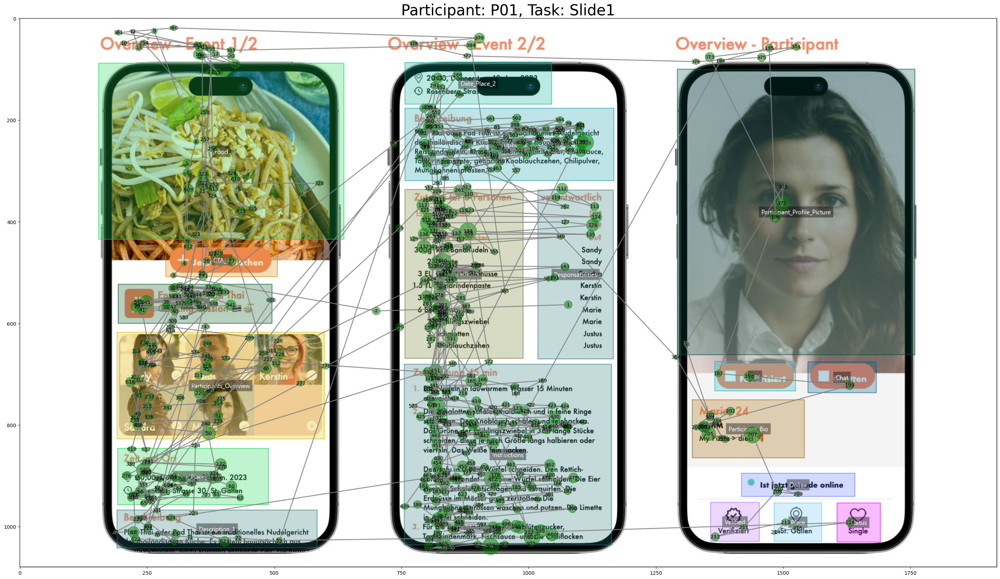

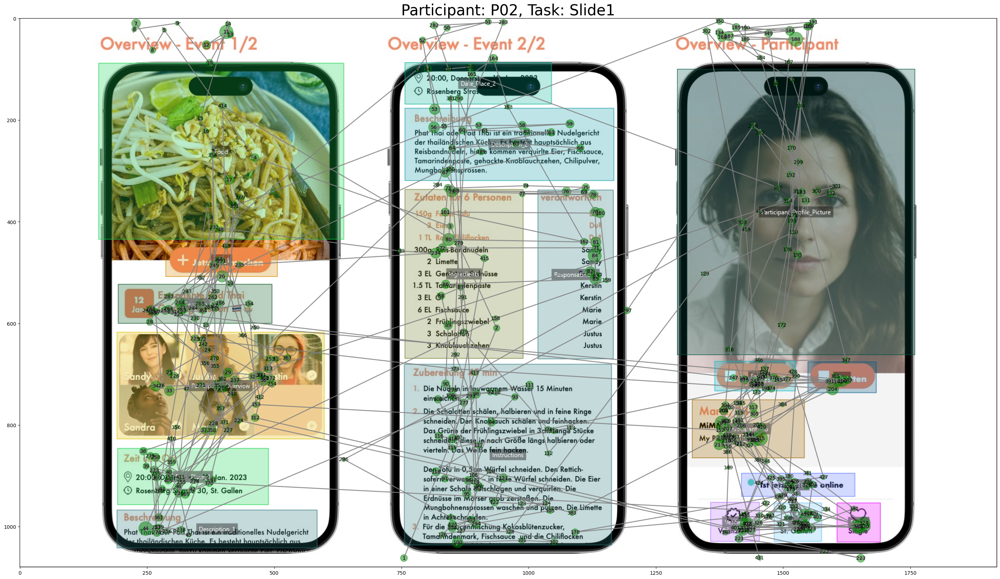

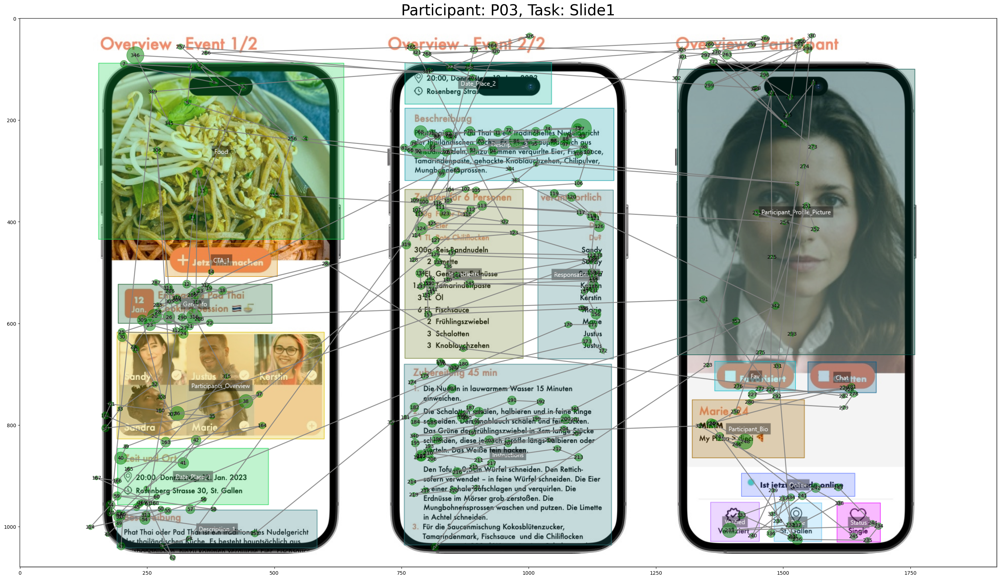

In [10]:
# Iteratate over the participants and tasks and plot the scan-path for each participant and task
for participant in fixationData['Respondent'].unique():
    
    for task in fixationData['SourceStimuliName'].unique():    
    
        # filter in the participant and task data data
        participantTaskFixationData= fixationData[(fixationData['Respondent']==participant) & (fixationData['SourceStimuliName']==task)].copy(deep=True)
        participantTaskFixationData = participantTaskFixationData.reset_index(drop=True)

        # Path to the stimulus image
        image_path = STIMULUS_IMAGE_WITH_AOIS_PATH+task+'.png'

        # Initiate a coordinate system with a background image
        fig, ax = utils.initPlotContainer(image_path)

        # set title
        ax.set_title(f'Participant: {participant}, Task: {task}', fontsize=30)

        # get the length of the fixations dataframe
        fixationsDataFrameLength = len(participantTaskFixationData)

        # plot fixations (with the size of the markers relative to the fixation duration)
        ax.scatter(participantTaskFixationData["Fixation X"], participantTaskFixationData["Fixation Y"], s= participantTaskFixationData["Fixation Duration"], c='green', alpha=0.5)

        # iterate through fixationData
        for index, row in participantTaskFixationData.iterrows():
            # assign an incremental number to each fixation      
            ax.annotate(str(index+1), (row['Fixation X'],row['Fixation Y']), alpha=1, horizontalalignment='center', verticalalignment='center', multialignment='center')
            # connect consecutive pairs of fixations with edges  
            if index<fixationsDataFrameLength-1:
                ax.arrow(row['Fixation X'],row['Fixation Y'], participantTaskFixationData.iloc[index+1]['Fixation X']-row['Fixation X'],participantTaskFixationData.iloc[index+1]['Fixation Y']-row['Fixation Y'], fc='grey', ec='grey', alpha=.7, fill=True, shape='full', width=1, head_width=5, head_starts_at_zero=False, overhang=0)

In [11]:
#----------------------------------------------------------------------------------------
#
#
# 3. Heatmap plots
#
#
#----------------------------------------------------------------------------------------

AttributeError: `np.NaN` was removed in the NumPy 2.0 release. Use `np.nan` instead.

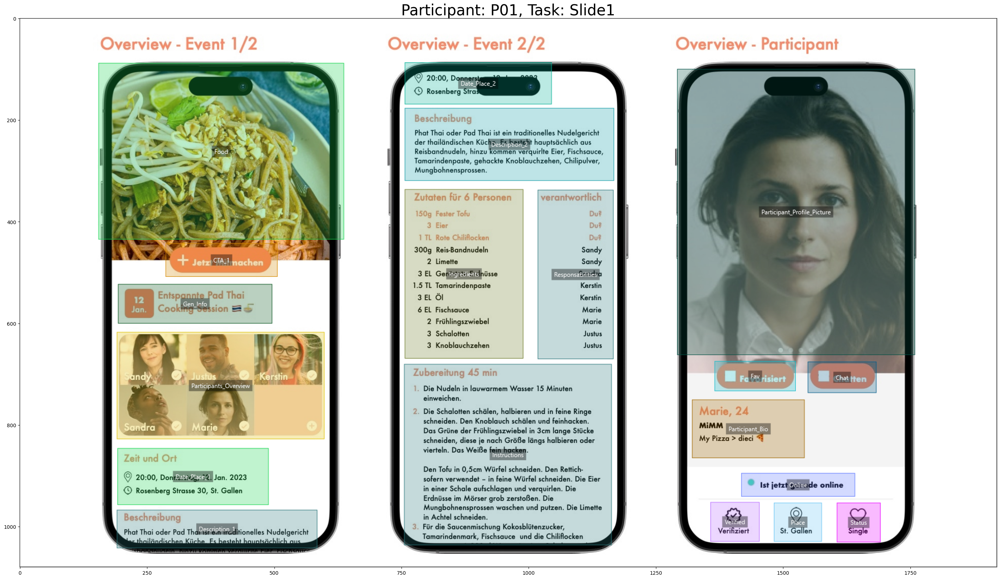

In [12]:
# Iteratate over the participants and tasks and plot the heatmap for each participant and task
for participant in fixationData['Respondent'].unique():
    
    for task in fixationData['SourceStimuliName'].unique():    
    
        # filter in the participant and task data
        participantTaskFixationData= fixationData[(fixationData['Respondent']==participant) & (fixationData['SourceStimuliName']==task)].copy(deep=True)

        # Path to the stimulus image
        image_path = STIMULUS_IMAGE_WITH_AOIS_PATH+task+'.png'

        # Initiate a coordinate system with a background image
        fig, ax = utils.initPlotContainer(image_path)

        # set title
        ax.set_title(f'Participant: {participant}, Task: {task}', fontsize=30)

        # Gaussian settings
        gwh = 200
        gsdwh = gwh/6
        gaus = utils.gaussian(gwh,gsdwh)

        strt = int(gwh/2)
        heatmapsize = int(DISPLAY_SIZE[1] + 2*strt), int(DISPLAY_SIZE[0] + 2*strt)
        heatmap = numpy.zeros(heatmapsize, dtype=float)

        # create heatmap (adapted from PyGazeAnalyser https://github.com/esdalmaijer/PyGazeAnalyser/)
        for index, row in participantTaskFixationData.iterrows():
            # get x and y coordinates of fixations
            # x and y - indices of heatmap array. must be integers
            x = strt + int(row['Fixation X']) - int(gwh/2)
            y = strt + int(row['Fixation Y']) - int(gwh/2)
            # correct Gaussian size if either coordinate falls outside of
            # display boundaries
            if (not 0 < x < DISPLAY_SIZE[0]) or (not 0 < y < DISPLAY_SIZE[1]):
                hadj=[0,gwh];vadj=[0,gwh]
                if 0 > x:
                    hadj[0] = abs(x)
                    x = 0
                elif DISPLAY_SIZE[0] < x:
                    hadj[1] = gwh - int(x-DISPLAY_SIZE[0])
                if 0 > y:
                    vadj[0] = abs(y)
                    y = 0
                elif DISPLAY_SIZE[1] < y:
                    vadj[1] = gwh - int(y-DISPLAY_SIZE[1])
                # add adjusted Gaussian to the current heatmap
                try:
                    heatmap[y:y+vadj[1],x:x+hadj[1]] += gaus[vadj[0]:vadj[1],hadj[0]:hadj[1]] * row['Fixation Duration']
                except:
                    # fixation was probably outside of display
                    pass
            else:				
                # add Gaussian to the current heatmap
                heatmap[y:y+gwh,x:x+gwh] += gaus * row['Fixation Duration']

        # resize heatmap
        heatmap = heatmap[strt:DISPLAY_SIZE[1]+strt,strt:DISPLAY_SIZE[0]+strt]
        # remove zeros
        lowbound = numpy.mean(heatmap[heatmap>0])
        heatmap[heatmap<lowbound] = numpy.nan
        # draw heatmap on top of image
        ax.imshow(heatmap, cmap='jet', alpha=0.5)
